# King County's House Price Dataset


<html>

<p>The Fisrt step before performing any model on our dataset, is getting more familiar with it. The purposed dataset contains house sale prices for King County, which includes Seattle. It includes homes sold between May 2014 and May 2015. There are 21 columns in the raw dataset but not all of them are data features.
</p>
    

<p>The features for our data are:</p>

<ls>
    <li>Selling date</li>
<li>Selling price</li>
<li>Number of bedrooms</li>
<li>Number of bathrooms</li>
<li>Area of living</li>
<li>Area of lot</li>
<li>Number of floors</li>
<li>Having waterfront</li>
<li>view</li>
<li>condition</li>
<li>grade</li>
<li>Area of above</li>
<li>Area of basement</li>
<li>year built</li>
<li>year renovated</li>
<li>zipcode</li>
<li>latitude</li>
<li>longitude</li>
<li>Area of living15</li>
<li>Area of lot15</li>
    </ls>
    
<p>We use pandas library to load the dataset, which is located in the root directory of the current notebook. Loading 
    numpy library for data manipulation, and seaborn library for data visualization would also take place at this stage</p>
</html>



In [22]:
import pandas as pd
import numpy as np
import seaborn as sns
import matplotlib.pyplot as plt
from scipy import stats
from datetime import date

path = './archive/'

kc_data = pd.read_csv(path + '/kc_house_data.csv')
kc_data.head() # we usually use head method to see the first 5 rows of the dataset to make sure everything is fine

,id,date,price,bedrooms,bathrooms,sqft_living,sqft_lot,floors,waterfront,view,...,grade,sqft_above,sqft_basement,yr_built,yr_renovated,zipcode,lat,long,sqft_living15,sqft_lot15
0,7129300520,20141013T000000,221900.0,3,1.00,1180,5650,1.0,0,0,...,7,1180,0,1955,0,98178,47.5112,-122.257,1340,5650
1,6414100192,20141209T000000,538000.0,3,2.25,2570,7242,2.0,0,0,...,7,2170,400,1951,1991,98125,47.7210,-122.319,1690,7639
2,5631500400,20150225T000000,180000.0,2,1.00,770,10000,1.0,0,0,...,6,770,0,1933,0,98028,47.7379,-122.233,2720,8062
3,2487200875,20141209T000000,604000.0,4,3.00,1960,5000,1.0,0,0,...,7,1050,910,1965,0,98136,47.5208,-122.393,1360,5000
4,1954400510,20150218T000000,510000.0,3,2.00,1680,8080,1.0,0,0,...,8,1680,0,1987,0,98074,47.6168,-122.045,1800,7503


# Finding Null and NaN cells

<html>
    <p>Finding Null cells and None-Number cells is an essential step for data preprocessing. In this stage we use two 
    methods to find the Null and NaN percentage for each column. We would also set an treshold to remove a whole
    column, if there were too missing values. Otherwise, the missing values would be replaced by the mean of that column.
    (Since our data consist numerical values we used mean. for categorical columns we can use mod instead of mean.</p>
    
    
</html>

In [23]:
# printing missing value's percentage for each data column

print('Percentage of NaN cells:')
print(kc_data.isna().sum()/len(kc_data)*100)
print('---')
print('Percentage of Null cells:')
print(kc_data.isnull().sum()/len(kc_data)*100)

# Droping columns that contain too missing values. If there were few missing values, they would be replaced by
# mean value of that column.

kc_data.dropna(thresh = 0.8 * len(kc_data), axis=1, inplace=True)
numeric               = kc_data.select_dtypes(include=np.number)
numeric_columns       = numeric.columns
kc_data[numeric_columns] = kc_data[numeric_columns].fillna(kc_data.mean())

print('---')
print('Data is cleaned')
kc_data

Percentage of NaN cells:
id               0.0
date             0.0
price            0.0
bedrooms         0.0
bathrooms        0.0
sqft_living      0.0
sqft_lot         0.0
floors           0.0
waterfront       0.0
view             0.0
condition        0.0
grade            0.0
sqft_above       0.0
sqft_basement    0.0
yr_built         0.0
yr_renovated     0.0
zipcode          0.0
lat              0.0
long             0.0
sqft_living15    0.0
sqft_lot15       0.0
dtype: float64
---
Percentage of Null cells:
id               0.0
date             0.0
price            0.0
bedrooms         0.0
bathrooms        0.0
sqft_living      0.0
sqft_lot         0.0
floors           0.0
waterfront       0.0
view             0.0
condition        0.0
grade            0.0
sqft_above       0.0
sqft_basement    0.0
yr_built         0.0
yr_renovated     0.0
zipcode          0.0
lat              0.0
long             0.0
sqft_living15    0.0
sqft_lot15       0.0
dtype: float64
---
Data is cleaned


C:\Users\esmae\AppData\Local\Temp/ipykernel_4532/2346758947.py:15: FutureWarning: Dropping of nuisance columns in DataFrame reductions (with 'numeric_only=None') is deprecated; in a future version this will raise TypeError.  Select only valid columns before calling the reduction.
  kc_data[numeric_columns] = kc_data[numeric_columns].fillna(kc_data.mean())


,id,date,price,bedrooms,bathrooms,sqft_living,sqft_lot,floors,waterfront,view,...,grade,sqft_above,sqft_basement,yr_built,yr_renovated,zipcode,lat,long,sqft_living15,sqft_lot15
0,7129300520,20141013T000000,221900.0,3,1.00,1180,5650,1.0,0,0,...,7,1180,0,1955,0,98178,47.5112,-122.257,1340,5650
1,6414100192,20141209T000000,538000.0,3,2.25,2570,7242,2.0,0,0,...,7,2170,400,1951,1991,98125,47.7210,-122.319,1690,7639
2,5631500400,20150225T000000,180000.0,2,1.00,770,10000,1.0,0,0,...,6,770,0,1933,0,98028,47.7379,-122.233,2720,8062
3,2487200875,20141209T000000,604000.0,4,3.00,1960,5000,1.0,0,0,...,7,1050,910,1965,0,98136,47.5208,-122.393,1360,5000
4,1954400510,20150218T000000,510000.0,3,2.00,1680,8080,1.0,0,0,...,8,1680,0,1987,0,98074,47.6168,-122.045,1800,7503
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
21608,263000018,20140521T000000,360000.0,3,2.50,1530,1131,3.0,0,0,...,8,1530,0,2009,0,98103,47.6993,-122.346,1530,1509
21609,6600060120,20150223T000000,400000.0,4,2.50,2310,5813,2.0,0,0,...,8,2310,0,2014,0,98146,47.5107,-122.362,1830,7200
21610,1523300141,20140623T000000,402101.0,2,0.75,1020,1350,2.0,0,0,...,7,1020,0,2009,0,98144,47.5944,-122.299,1020,2007
21611,291310100,20150116T000000,400000.0,3,2.50,1600,2388,2.0,0,0,...,8,1600,0,2004,0,98027,47.5345,-122.069,1410,1287


# Date Column Transformation

<html>
    
<p>Since the Date column is not in a proper type and also has a 'Object' type, we should transform this layer to a type that we can use in our future models. There are several ways to transform a date column, for example transform it to a categorical type or continues form. In this project we would use a continues form. Note that the date format is 'yyyymmddhhmmss' which doesn't have any hhmmss. </p>
    
</html>

In [24]:
# Transforming object type to integer

kc_data['date'] = kc_data['date'].map(lambda x: int(x[:8]))

# finding the minimum value in data column to make it as the base date for others.

base_date = min(kc_data['date'])

# This function turns integer dates to datetime format and calculate difference between entry date
# and minimum date, also known as base_date

def date_func(c_date):
    base = base_date
    y_date = c_date //10000
    m_date = c_date % 10000 // 100
    d_date = c_date % 100 
    
    c_date = date(y_date,m_date,d_date)
    
    y_base = base //10000
    m_base = base % 10000 // 100
    d_base = base % 100    
    
    base = date(y_base,m_base,d_base)
    
    return (c_date - base).days

# applying date_func to all rows in the dataframe

kc_data['date'] = kc_data['date'].map(lambda x:date_func(x))

kc_data

,id,date,price,bedrooms,bathrooms,sqft_living,sqft_lot,floors,waterfront,view,...,grade,sqft_above,sqft_basement,yr_built,yr_renovated,zipcode,lat,long,sqft_living15,sqft_lot15
0,7129300520,164,221900.0,3,1.00,1180,5650,1.0,0,0,...,7,1180,0,1955,0,98178,47.5112,-122.257,1340,5650
1,6414100192,221,538000.0,3,2.25,2570,7242,2.0,0,0,...,7,2170,400,1951,1991,98125,47.7210,-122.319,1690,7639
2,5631500400,299,180000.0,2,1.00,770,10000,1.0,0,0,...,6,770,0,1933,0,98028,47.7379,-122.233,2720,8062
3,2487200875,221,604000.0,4,3.00,1960,5000,1.0,0,0,...,7,1050,910,1965,0,98136,47.5208,-122.393,1360,5000
4,1954400510,292,510000.0,3,2.00,1680,8080,1.0,0,0,...,8,1680,0,1987,0,98074,47.6168,-122.045,1800,7503
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
21608,263000018,19,360000.0,3,2.50,1530,1131,3.0,0,0,...,8,1530,0,2009,0,98103,47.6993,-122.346,1530,1509
21609,6600060120,297,400000.0,4,2.50,2310,5813,2.0,0,0,...,8,2310,0,2014,0,98146,47.5107,-122.362,1830,7200
21610,1523300141,52,402101.0,2,0.75,1020,1350,2.0,0,0,...,7,1020,0,2009,0,98144,47.5944,-122.299,1020,2007
21611,291310100,259,400000.0,3,2.50,1600,2388,2.0,0,0,...,8,1600,0,2004,0,98027,47.5345,-122.069,1410,1287


# Finding and Removing Outliers

<html>
    
<p>One easy way is computing z-score for each cell and then remove high z-score values, based on a certain treshold.
    z-score can be computed as below:</p>
    
</html>

$ \begin{align} 
\large Z-Score =  \frac {x - \mu}{\sigma}
\end{align} $

<html>
    
<p>Using z-score is highly depends on the column that we are using. For example, for the column 'yr_renovate", which is
    explaining wether a house has been renovated or not, z-score is not usefull in the first step, and more transformations
    have to be considered before using it. also, the treshold for various columns, could be different, and this can be measured
    by that columns data distribuation. So, we need to visualize each colums first to have a better understanding of each
    column, and then decide the value of z treshold.</p>
    
</html>

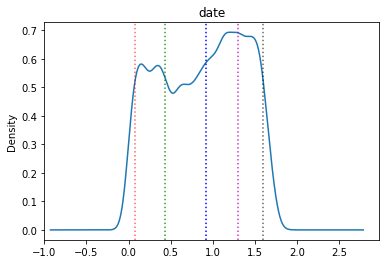

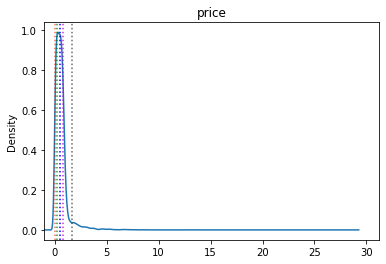

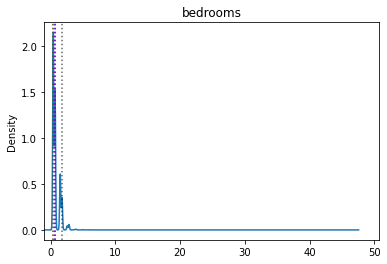

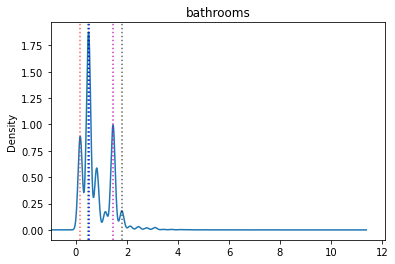

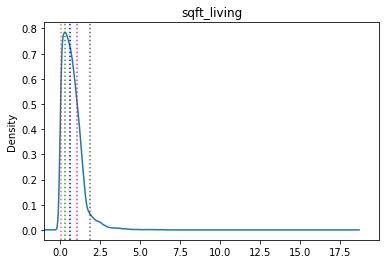

...

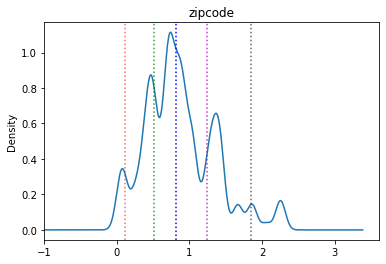

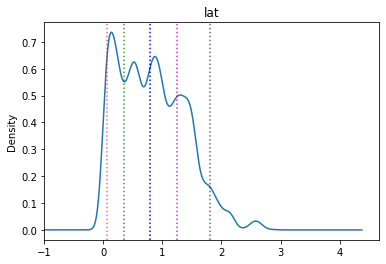

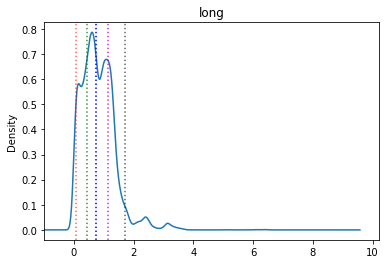

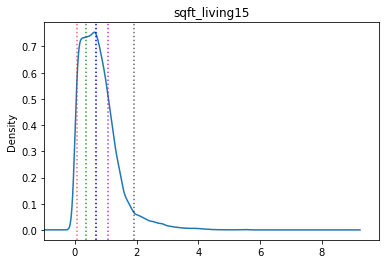

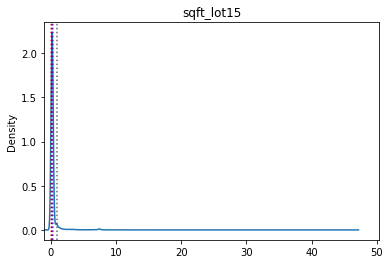

In [25]:
# Droping 'id' and 'date' column since the first one is note a feature and the second one is not a numerical feature

data = kc_data.drop(['id',],axis = 1)

# Calculating z-score value
z_score = np.abs(stats.zscore(data))

# Plotting KDE plot for each feature, with five different quantile valuse to give a better understnding of data distribution

for feature in z_score.columns:
    fig, ax = plt.subplots()
    z_score[feature].plot(kind = 'kde')
    ax.set_title(feature)
    
    quant_5, quant_25, quant_50, quant_75, quant_95 = z_score[feature].quantile(0.05), z_score[feature].quantile(0.25), z_score[feature].quantile(0.5), z_score[feature].quantile(0.75), z_score[feature].quantile(0.95)
    quants = [[quant_5, 0.6, 'r'], [quant_25, 0.8, 'g'], [quant_50, 1, 'b'],  [quant_75, 0.8, 'm'], [quant_95, 0.6,'k']]
    for i in quants:
        ax.axvline(i[0],alpha = i[1], linestyle = ":",color = i[2])
    ax.set_xlim(xmin = -1)


<html>
    
<p>As it can be seen from the visualization, there are outliers in some columns:</p>
<ls>
    <li>price</li>
    <li>bedrooms</li>
    <li>bathrooms</li>
    <li>sqft_living</li>
    <li>sqft_lot</li>
    <li>sqft_above</li>
    <li>sqft_basement</li>
</ls>

<p>One way to remove outliers from the data is to set a treshold for all feature's z-score. we should notice that some features like yr_renovated and sqft_basement need some tranformations to find real ouliers instead of correct data.</p>    

<p>The transformation has been applied to the dataframe in the last cells of this notebook by replacing 0 values of yr_renovated with yr_built of that house.</p>
    

</html>

<html>
    
<p>Now we can compute z-score for yr_renovated, and sqft_basement. The following graphs illustrate data distribution for these columns:</p>
    

</html>

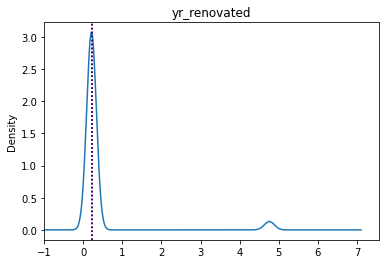

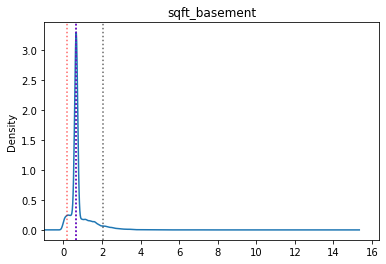

In [26]:
# Calculating z-score value
new_z_score = np.abs(stats.zscore(data))

# Plotting KDE plot for each feature, with five different quantile valuse to give a better understnding of data distribution

for feature in ['yr_renovated','sqft_basement',]:
    fig, ax = plt.subplots()
    new_z_score[feature].plot(kind = 'kde')
    ax.set_title(feature)
    
    quant_5, quant_25, quant_50, quant_75, quant_95 = new_z_score[feature].quantile(0.05),new_z_score[feature].quantile(0.25), new_z_score[feature].quantile(0.5), new_z_score[feature].quantile(0.75),new_z_score[feature].quantile(0.95)
    quants = [[quant_5, 0.6, 'r'], [quant_25, 0.8, 'g'], [quant_50, 1, 'b'],  [quant_75, 0.8, 'm'], [quant_95, 0.6,'k']]
    for i in quants:
        ax.axvline(i[0],alpha = i[1], linestyle = ":",color = i[2])
    ax.set_xlim(xmin = -1)


<html>
    
<p> Using Z-score graphs and other consideration that is mentioned in 'Outlier Checking' notebook, the only outlier is on row 15870 (which has 33 bedrooms!). </p>
    

</html>

In [27]:
cleaned = data.drop(labels=15870 , axis = 0)
cleaned

,date,price,bedrooms,bathrooms,sqft_living,sqft_lot,floors,waterfront,view,condition,grade,sqft_above,sqft_basement,yr_built,yr_renovated,zipcode,lat,long,sqft_living15,sqft_lot15
0,164,221900.0,3,1.00,1180,5650,1.0,0,0,3,7,1180,0,1955,0,98178,47.5112,-122.257,1340,5650
1,221,538000.0,3,2.25,2570,7242,2.0,0,0,3,7,2170,400,1951,1991,98125,47.7210,-122.319,1690,7639
2,299,180000.0,2,1.00,770,10000,1.0,0,0,3,6,770,0,1933,0,98028,47.7379,-122.233,2720,8062
3,221,604000.0,4,3.00,1960,5000,1.0,0,0,5,7,1050,910,1965,0,98136,47.5208,-122.393,1360,5000
4,292,510000.0,3,2.00,1680,8080,1.0,0,0,3,8,1680,0,1987,0,98074,47.6168,-122.045,1800,7503
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
21608,19,360000.0,3,2.50,1530,1131,3.0,0,0,3,8,1530,0,2009,0,98103,47.6993,-122.346,1530,1509
21609,297,400000.0,4,2.50,2310,5813,2.0,0,0,3,8,2310,0,2014,0,98146,47.5107,-122.362,1830,7200
21610,52,402101.0,2,0.75,1020,1350,2.0,0,0,3,7,1020,0,2009,0,98144,47.5944,-122.299,1020,2007
21611,259,400000.0,3,2.50,1600,2388,2.0,0,0,3,8,1600,0,2004,0,98027,47.5345,-122.069,1410,1287


<html>
    
<p>1 cells that were not in a reasonable range of others have been removed from the table.</p>
    

</html>

# Finding Co-related columns

<html>
    
<p>In this step we will remove features that are highly co-related to each other, since keeping both of them in the dataset would affect the accuracy of our models to predict price of a house based on its features. First, we would visualize pair graphs among data features, and after that using a correlation matrix, we would correct data features.</p>
    

</html>

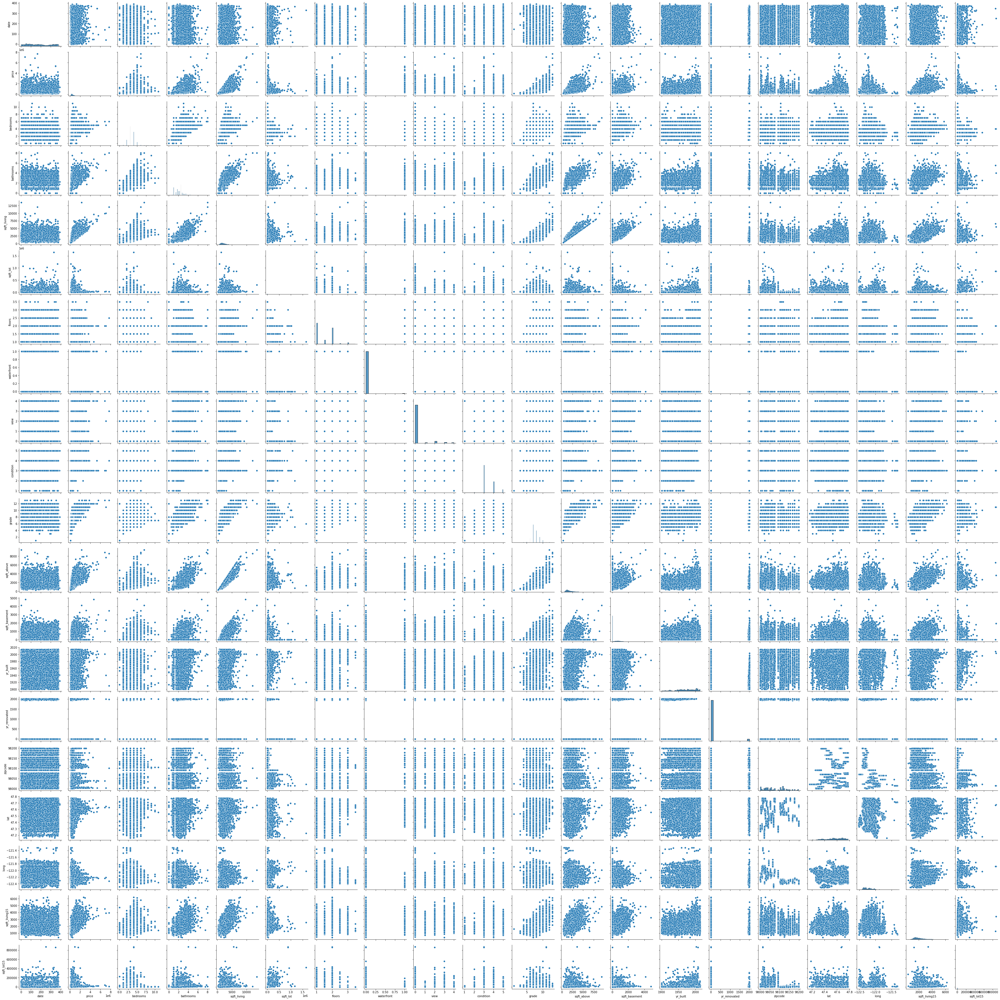

In [28]:
sns.pairplot(cleaned)

<html>
    
<p>We can also plot each feature in comparison to price, since price is the target for this dataset</p>
    

</html>

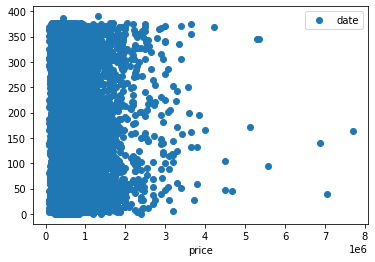

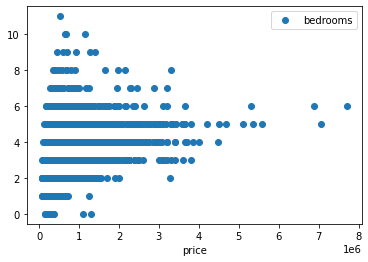

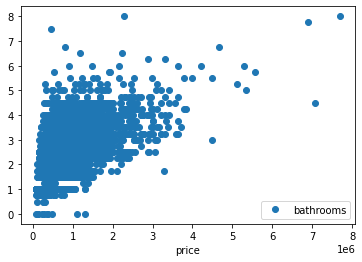

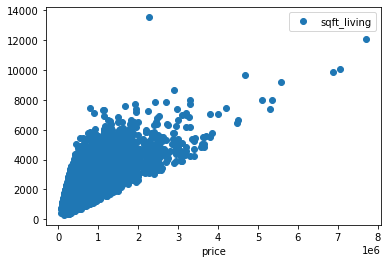

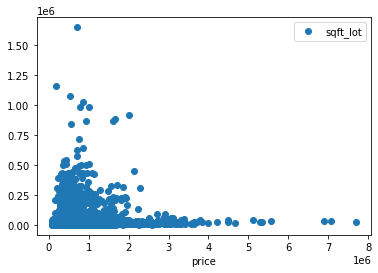

...

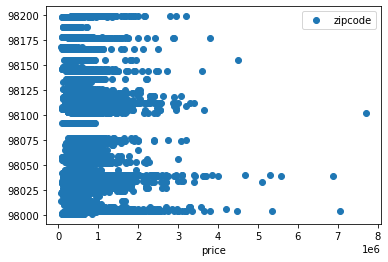

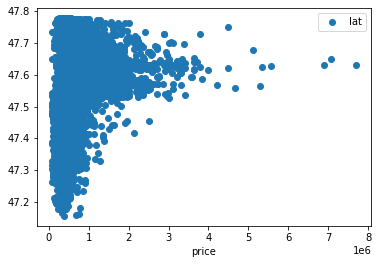

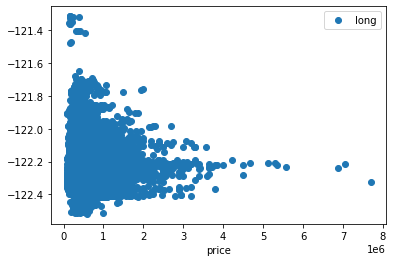

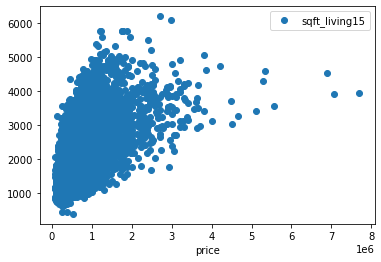

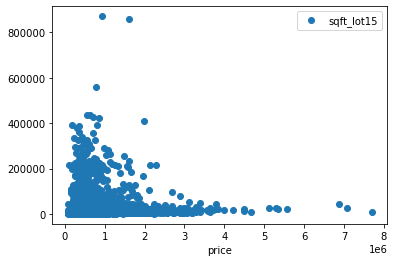

In [29]:
columns = list(cleaned.columns)
columns.remove('price')


for feature in columns:
    cleaned.plot(x='price', y=feature , style='o')
    

<AxesSubplot:>

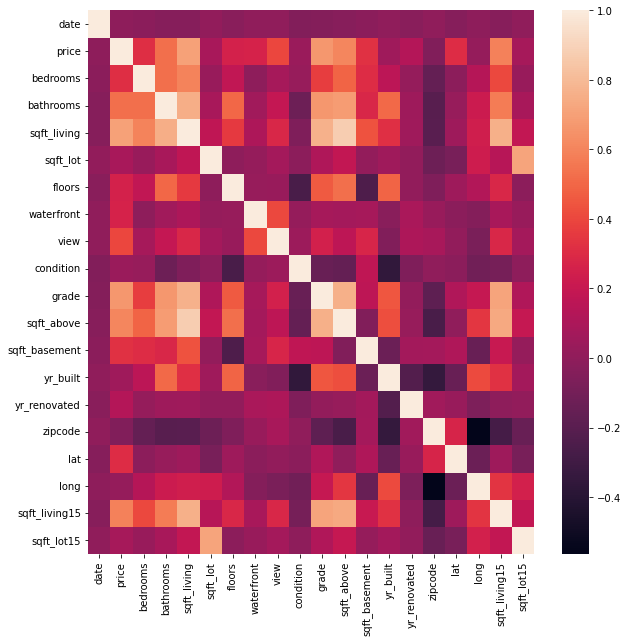

In [30]:
# Creating pearson correlation matrix and ploting it
cor_mat = cleaned.corr(method= 'pearson')
fig = plt.figure(figsize=(10,10))
sns.heatmap(cor_mat)

<html>
    
<p>Since sqft_basement is linear combination of other layers, it can be removed from the datafram. Also, yr_renovated is not a good feature for this data frame, as it has been stated in 'Outlier checking' notebook, So we can have a transformation for 0 values and change them to the property's year of built.</p>
    

</html>

In [32]:
final_v_dataset = cleaned.drop(['sqft_basement',], axis = 1)



In [33]:
final_v_dataset['yr_renovated']  = np.where(final_v_dataset['yr_renovated'] == 0, final_v_dataset['yr_built'] , final_v_dataset['yr_renovated'])
final_v_dataset

,date,price,bedrooms,bathrooms,sqft_living,sqft_lot,floors,waterfront,view,condition,grade,sqft_above,yr_built,yr_renovated,zipcode,lat,long,sqft_living15,sqft_lot15
0,164,221900.0,3,1.00,1180,5650,1.0,0,0,3,7,1180,1955,1955,98178,47.5112,-122.257,1340,5650
1,221,538000.0,3,2.25,2570,7242,2.0,0,0,3,7,2170,1951,1991,98125,47.7210,-122.319,1690,7639
2,299,180000.0,2,1.00,770,10000,1.0,0,0,3,6,770,1933,1933,98028,47.7379,-122.233,2720,8062
3,221,604000.0,4,3.00,1960,5000,1.0,0,0,5,7,1050,1965,1965,98136,47.5208,-122.393,1360,5000
4,292,510000.0,3,2.00,1680,8080,1.0,0,0,3,8,1680,1987,1987,98074,47.6168,-122.045,1800,7503
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
21608,19,360000.0,3,2.50,1530,1131,3.0,0,0,3,8,1530,2009,2009,98103,47.6993,-122.346,1530,1509
21609,297,400000.0,4,2.50,2310,5813,2.0,0,0,3,8,2310,2014,2014,98146,47.5107,-122.362,1830,7200
21610,52,402101.0,2,0.75,1020,1350,2.0,0,0,3,7,1020,2009,2009,98144,47.5944,-122.299,1020,2007
21611,259,400000.0,3,2.50,1600,2388,2.0,0,0,3,8,1600,2004,2004,98027,47.5345,-122.069,1410,1287


In [ ]:
# Install a pip package in the current Jupyter kernel to install folium for next cells
import sys
!{sys.executable} -m pip install folium

<html>
    
<p>In this final section we would examine latitude and lonitude numbers for our data. For this examination we use folium library, which can be installed easily.</p>
   

</html>

In [34]:
# note that for running this block folium should be installed

import folium


#selecting appropriate zoom level for visualization

king_county_map = folium.Map(location = [47.49, -121.99], zoom_start= 9) #selecting a location arround king county
king_county_features = folium.map.FeatureGroup()

#plot every node in the data
for lat, long in zip(cleaned['lat'],cleaned['long']):
    king_county_features.add_child(folium.features.CircleMarker([lat,long], radius=1, color = 'red',)) 

    king_county_map.add_child(king_county_features)

king_county_map

<html>
    
<p>As it can been seen, all locations are within a reasonable region of Washington states. </p>
   

</html>

<html>
    
<p>Finally we can save our result, which is ready to be used by our models.</p>
   

</html>

In [35]:
final_v_dataset.to_csv(path + 'kc_preprocessed.csv')

final_v_dataset

,date,price,bedrooms,bathrooms,sqft_living,sqft_lot,floors,waterfront,view,condition,grade,sqft_above,yr_built,yr_renovated,zipcode,lat,long,sqft_living15,sqft_lot15
0,164,221900.0,3,1.00,1180,5650,1.0,0,0,3,7,1180,1955,1955,98178,47.5112,-122.257,1340,5650
1,221,538000.0,3,2.25,2570,7242,2.0,0,0,3,7,2170,1951,1991,98125,47.7210,-122.319,1690,7639
2,299,180000.0,2,1.00,770,10000,1.0,0,0,3,6,770,1933,1933,98028,47.7379,-122.233,2720,8062
3,221,604000.0,4,3.00,1960,5000,1.0,0,0,5,7,1050,1965,1965,98136,47.5208,-122.393,1360,5000
4,292,510000.0,3,2.00,1680,8080,1.0,0,0,3,8,1680,1987,1987,98074,47.6168,-122.045,1800,7503
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
21608,19,360000.0,3,2.50,1530,1131,3.0,0,0,3,8,1530,2009,2009,98103,47.6993,-122.346,1530,1509
21609,297,400000.0,4,2.50,2310,5813,2.0,0,0,3,8,2310,2014,2014,98146,47.5107,-122.362,1830,7200
21610,52,402101.0,2,0.75,1020,1350,2.0,0,0,3,7,1020,2009,2009,98144,47.5944,-122.299,1020,2007
21611,259,400000.0,3,2.50,1600,2388,2.0,0,0,3,8,1600,2004,2004,98027,47.5345,-122.069,1410,1287
